# Dynap-SE2 developer notes

Dynap-SE2 rockpool API provides an abstract Dynap-SE2 machine that operates in the same parameter space as Dynap-SE2 processors. 
More, it provides all the tools required to optimize a network, to convert a simulation setting to a hardware configuration, and to convert a hardware configuration to a simulation setting.

It's possible to go from simulation to deployment:

* Define a rockpool network 
* Map this network to a hardware specification
* Quantize the parameters
* Obtain a samna configuration
* Connect and configure a Dynap-SE2 chip 
* Run a real-time, hardware simulation

*Simulation -> Device (pseudo-code)*

```python
    # Define
    net = Sequential(LinearJax((Nin, Nrec)), DynapSim((Nrec, Nrec)))

    # Map
    spec = mapper(net.as_graph())
    spec.update(autoencoder_quantization(**spec))
    config = config_from_specification(**spec)

    # Connect 
    se2_devices = find_dynapse_boards()
    se2 = DynapseSamna(se2_devices[0], **config)
    out, state, rec = se2(raster, record=True)
```

It's also possible to go from hardware configuration to simulation:

*Device -> Simulation (pseudo-code)*

```python
    net = dynapsim_net_from_config(**config)
    out, state, rec = net(raster, record=True)
```

If you haven't seen already there are great tutorials explaining how to use the API support

In this tutorial, the development details of the packages that belong to the `devices.dynapse` library are explained. The package structure and the key components are displayed in the figure below. The roles of each of them are explained throughout the document.

In [1]:
from IPython.display import Image
Image("uml/se2_api.png", width="1024")

## `devices.dynapse.simulation`

In [2]:
Image("uml/simulation.png", width="1024")

Simulation package encapsulates the modules and utilities required to execute a computational simulation based on VLSI dynamics. The key component, `DynapSim` is a `jax`-backend neuron model definition that solves analog VLSI circuit equations to provide a simulated machine. It uses forward Euler updates to predict the time-dependent dynamics and solves the characteristic circuit transfer functions in time.

`DynapSim` inherits from `JaxModule`; therefore, its compatible to work with the other jax-backend rockpool modules in combination.

```python
Sequential(LinearJax((n_in,n_rec1)), LIFJax((n_rec1,n_rec1)), LinearJax((n_rec1,n_rec2)), DynapSim((n_rec2,n_rec2)))
```


To assure operation flexibility, all the current parameters that we can change via bias generators on chip are object constructor parameters: `If_nmda`, `Igain_ahp`, `Igain_mem`, `Igain_syn`, `Ipulse_ahp`, `Ipulse`, `Iref`, `Ispkthr`, `Itau_ahp`, `Itau_mem`, `Itau_syn`, `Iw_ahp`. Also, even though layout parameters are fixed on production, in simulator we have the flexibility to change. Therefore all layout depended silicon parameters: `C_ahp`, `C_syn`, `C_pulse_ahp`, `C_pulse`, `C_ref`, `C_mem`, `Io`, `kappa_n`, `kappa_p`, `Ut`, `Vth` are also defined as are object constructor parameters. The statets `iahp`,  `iampa`,  `igaba`,  `imem`,  `inmda`,  `ishunt`,  `spikes`,  `timer_ref`,  `vmem` are only stored as an attribute but cannot be changed externally. Only a state evolution can change their values.

Weight handling in Dynap-SE2 has 2 sides: core-wide base currents and connection specific bit-masks. For the sake of a better optimization support, the simulator is free from the hardware constraints applying on the synapses. Weight matrices are regular 32-bit floating point arrays which subject to post-training quantization. `Iscale` sets a reference point for the base weight currents. However, it's **not** absolutely necessary for post-training quantization. In later releases, it can be replaced by a search algorithm which automatically finds a scaling reference which projects the synapses best to the chip.

### Utilities

`simulation` package stores the mismatch prototype definitions. `frozen_mismatch_prototype()` and `dynamic_mismatch_prototype()` are the convenience methods to analyse any `rockpool` `jax` network and return a parameter subtree on which it makese sense to apply mismatch.

The package also provides surrogate gradient function definitions which are escpecially important applying a gradient-based optimization. Currently, only one definition is provided but there is always room for implementing more if required.

## `devices.dynapse.mapping`

In [3]:
Image("uml/mapping.png", width="1024")

Mapping package implements the functionality to obtain a Dynap-SE2 HDK hardware specification from an SNN. The main function `mapper()` projects a computational graph onto Dynap-SE2 architecture. Fundamentally, it clusters parameters in groups and specifies hardware posititons for neurons. `mapper()` does not require specifically a `DynapSim` network to project to a hardware specification because the conversion across different layers are possible. 

In rockpool, network modules overrides the abstract `as_graph()` method to be able to extract a simpler computational graph from a complex module. Computational graphs are intermediate representations which holds only the computationally important parameters. When applicable, they make it possible to convert the layers between each others while keeping the computational properties the same. 

`DynapseNeurons` serves as the intermediate representation to extract a computational graph from a `DynapSim` layer. It holds only the current values that can be **configured** on chip. So, neither the state currents nor the layout parameters stored. Currently, only from a `LIFNeuronWithSynsRealValue` to `DynapseNeurons` conversion is possible and the other way around is not implemented. This makes it possible to extract a computational graph from a multi-layer LIF (jax or torch) network and to convert it to a `DynapSim` computational graph. That is usually the first step of the mapping process.

`mapper()` uses the `lifnet_to_dynapsim()` conversion prior to any step in hardware specification to get a standard representation. `NPGrid` and `DFAPlacement` are the utility classes that helps the `lifnet_to_dynapsim()` to process a multi-layer network definition to obtain a computationally equivalent single layer definition. `NPGrid` builds virtual grids on a weight matrix and allocates logical regions for intermediate layers on the big recurrent weight matrix that the merged structure is to be projected. `DFAPlacement` defines a state machine that processes the multilayer structure and takes different actions regarding the different layers encountered. These are completely non user interfaced parts of the Dynap-SE2 API and implements the fundamentals of the hardware specification.

Succesfully pre-processing the SNNs, `mapper` reduces every SNN down to 3 connected graph modules. One `DynapseNeurons` object holding parameter current values of the hardware neurons. One `LinearWeights` object holding the input weights from the external connections to the hardware neurons, one `LinearWeights` object holding the recurrent weights between hardware neurons. A `DynapseGraphHolder` structure holds those graph modules and applies design rule checks to make sure that the specification is deployable so far.

In short, `mapper()` gets any SNN graph, process the layers, returns a hardware specification if nothing is wrong, and raises an error if it's impossible to deploy the given graph to a Dynap-SE2 HDK. The `mapping` package implements the functionality to process the SNN layers and obtain a hardware specification. However, it does not guarantee that the network is deployable. The later stages like quantization and configuration object generation can still determine some design rule violations that `mapper()` is unable to detect.

## `devices.dynapse.quantization`

In [4]:
Image("uml/quantization.png", width="1024")

Quantization package provides the tools to apply post-training quantization to the weights of a mapped network. At the simulation, a `DynapSim` weight matrix can get any floating point value. However, Dynap-SE2 chips do not provide a floating-point weight matrix configuration support. In Dynap-SE2, there is a restricted 4-bit weight matrix configuration support. The fact that the hardware does not support the floating point weight configuration obliges a post-process after training.

The quantization means converting the weight matrix values to values that can be applied in hardware. In Dynap-SE2, the weight values are configured by setting four base weight bits and choosing a combination of those base weights via bit masks specified CAMs. Therefore, each connection between neurons can select the weight current that their synaptic unit would use in 4-bit resolution. If the simulated weight matrix consists of values that can be expressed within a 4-bit inner product space, then a lossless conversion would be possible.

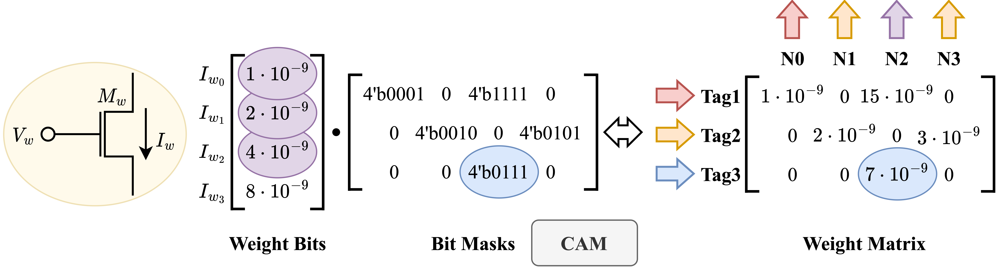

In [5]:
Image("images/autoencoder_lossless_2.png", width="1024")

Here, the initial 3x4 weight matrix can be expressed by 4 base weight currents and a 3x4 bitmask matrix. The elements of the bitmask indicate the elements of the intermediate base weight matrix to be added. However, in practice, weight matrices are bigger and lossless conversion in 4-bit inner product space is not a realistic scenario. Instead, weight matrices consisting of 32-bit floating point values can be quantized aiming for the minimum dissimilarity between the quantized version and the original one. `quantization` package uses a classical unsupervised machine learning approach to find an efficient coding of the weight matrix, namely AutoEncoder.

`DigitalAutoEncoder` is a simple single layer custom autoencoder implementation. The decoder weight matrix stands for the binary bitmasks of the synapses. To make sure that the decoder weights projected as binary, a binary thresholding applies to the decoding weights. In that setting the intermediate code, the output of the encoding, stands for the base weight currents and the decoder weight matrix stands for the global CAM configuration.

The `loss` subpackage provides custom loss functions designed to use in `DigitalAutoEncoder`'s optimization pipeline. The `gradient` subpackage provides the surrogate gradient functions because the binary appearance of the decoding weight matrix requires a special handling of the gradients due to similar reasons that we require surrogate graident implementation in SNN training. The `learn` subpackage, lastly provides a ready-to-use `jax` training pipeline. `learn_weights()` function takes the input and recurrent weight matrices as input and returns the global CAM configuration along with the base weight current setting with a default training setting. However, it can only be used to find the configuration for a single core.

The top level user facing `autoencoder_quantization()` function cuts all the complexity off and operates with the mapper function output directly.

```python
    spec = mapper(net.as_graph())
    spec.update(autoencoder_quantization(**spec))
```

`autoencoder_quantization()` executes the unsupervised weight configuration learning approach `learn_weights()` for each cluster seperately. The function subsets input and recurrent weights for each cluster and quantizes the weights according to regarding cluster's constraints. It brings the hardware specification one step forward, bringing it closer to the hardware.

## `devices.dynapse.parameters`

In [6]:
Image("uml/parameters.png", width="1024")

Parameters package collects the high-level parameters <-> currents <-> configuration (DAC : coarse, fine values) conversion utilities. The high level parameters mean the most abstract human-comprehensible and less hardware-configurable parameters like time constants and gain ratios. These parameters are the ones that logically make sense but cannot be directly applied on circuits. They always depends on some current values to indirectly influence the behaviour. For example a relation between a time constant ($\tau$) and the leakage current ${I_{\tau}}$ can be represented as

$$
    \tau = \dfrac{C_{syn}U_{T}}{\kappa I_{\tau}}
$$

The high_level parameters subpackage is responsible for reflecting the high-level parameters to their relative low-level conjugates. The low level sub-package stores nearly the same parameter space with the `DynapSim` layer. However, different from it, `DynapSimCore` specifies the `Isyn` currents in more detail : `I_ampa`, `I_gaba`, `I_nmda`, `I_shunt`. The reason that we cannot express them in `DynapSim` layer is that for the simulation, it's important to the flexibility to represent negative synaptic currents. However in hardware, negative currents are not supported. Instead, there are inhibitory synapses that can reproduce the negative connection effect. 

`DynapSimCore` can process a `samna` hardware configuration object and read the current values that the bias generator setting will produce. It can also find the digital to analog converter setting (`samna` hardware configuration) that will produce the currents indicated. So it support both way of operation and stand in the middle as an intermediate collector. `biasgen` subpackage utilities makes it possible to convert from the hardware configuration to current specification and vice versa.

`DynapSim` is on the other hand just uses those currents to compute the dynamics.

`DynapseNeurons`'s job definition looks similar to an encapsulated `DynapSimCore` package `DynapSimCurrents` but it's fundamentally different. They are both indermediate level representations standing at different levels. `DynapseNeurons` is a graph package granting the base for converting the rockpool jax layers between each others. On the other hand, `DynapSimCurrents` provides a data-class closer to the hardware description having clear specification for `Isyn` currents : `I_ampa`, `I_gaba`, `I_nmda`, `I_shunt`.


## `devices.dynapse.dynapsim_net`

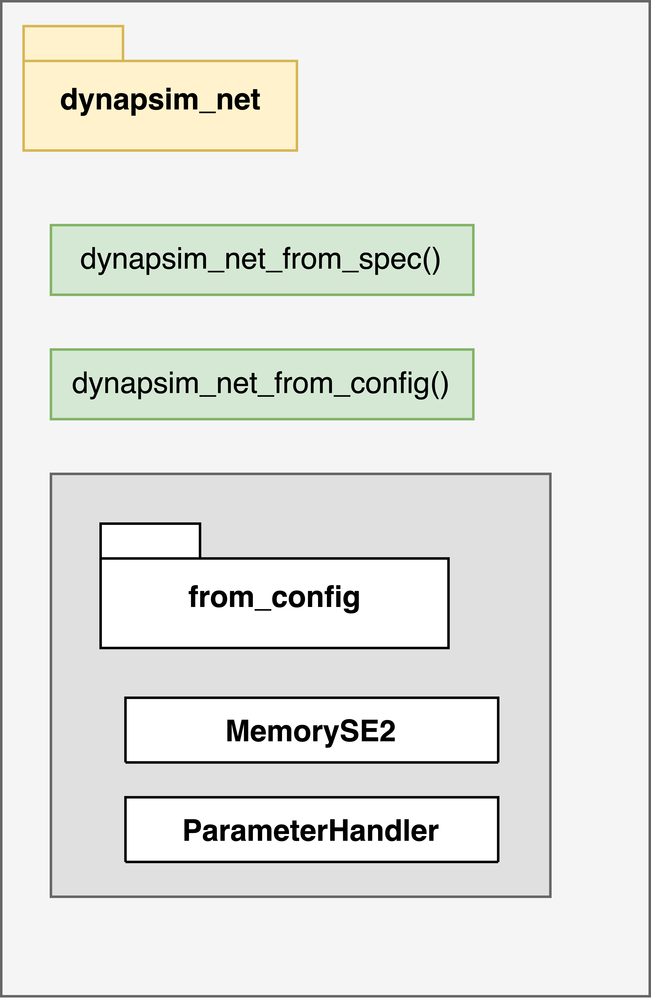

In [7]:
Image("uml/dynapsim_net.png", width=480)

`DynapSim` layers simulates the VLSI computation by solving analytical equations in time. However, for an end-to-end simulation it's not enough. `DynapSim` layers can only hold recurrent connections. Apart from the recurrent connections between the hardware neurons, there is also room for external input collection. To reflect the input connections, an extra linear input layer is required. So, a network processing external spiking input activity has at least two layers by default. 

The first layer is `nn.modules.LinearJax`, and it contains the input weights. Input weights define the connection strength between the external input channels (virtual neurons) to hardware neurons. The second layer is `devices.dynapse.DynapSim`, and it combines all the other layers. The recurrent weight matrix stored inside represents the synaptic weights between hardware neurons. 

Dynapsim_net package encapsulates some network getters that can process different objects and reconstruct a simulated SNN. `dynapsim_net_from_spec()` gets a specification and creates a sequential network consisting of a linear layer `LinearJax` (virtual connections) and a recurrent layer `DynapSim` (hardware connections). The input of the `dynapsim_net_from_spec()` is the same as the output of the `mapper()`. `dynapsim_net_from_config()` constructs a similar network by processing a samna configuration object `Dynapse2Configuration`. That is, `dynapsim_net_from_config()` translates a hardware configuration directly to a rockpool network by going through all the conversion steps. 

Reconstructing a network from a hardware configuration is not straightforward because 
* Connnectivity information is distributed across neuron's individual memory spaces, that has to be converted to weight matrices
* Parameters are stored as DAC configuartion (coarse and fine values) and each parameter has a different bias generator scaling.

To handle those issues and more carefully, **non-user facing** `MemorySE2` and `ParameterHandler` utility classes work in cooperation. Specifically, `MemorySE2` traces the connections between neurons indicated by the SRAM and CAM content. `ParameterHandler` leads the simulated network configuration by holding and processing the connectivity scheme obtained from `MemorySE2`. One step further, `DynapSimCore` converts the parameter configurations to simulation currents under the guidance of a `ParameterHandler` object.

## `dynapse.devices.hardware`

In [8]:
Image("uml/hardware.png", width="1024")

hardware package is heavily depended on `samna` and it builds the necessary tools on top of it to configure the chip and easily interface with it. The `config` subpackage has an important method that upties the mapping procedure : `config_from_specification()`. It gets the hardware specification having the quantized and clustered parameters, 

* translates every current parameter to a bias generator DAC setting (coarse & fine values), 
* allocates necessary SRAM and CAM cells,
* exports a samna configuration object and an input channel map. 

The resulting samna configuration object builds the simulated network on the hardware and the input channel map leads to dispatch the input events from PC to the indicated hardware destinations.

```python
    # Map
    spec = mapper(net.as_graph())
    spec.update(autoencoder_quantization(**spec))
    config = config_from_specification(**spec)
```

`DynapseSamna` bridges the gap between the chip and the PC. It provides a simulation-like interface for users, but executes all the operations like
* sending and receiving AER packages, 
* converting rasters to AER package sequences,
* applying and altering the hardware configuration
  
under  the hood. From the user's point of view, using a `DynapseSamna` network is almost the same as using any other rockpool spining network module. As an input, it accepts a discrete time series and it returns the (out, state, rec) tuple as the same as any other module. Differently, in record dictionary, we cannot see recordings of state currents, because it's impossible to read the state evolution in time reliably from the chip. Also, non-zero state initialization is impossible.

Also, the `DynapseSamna` object construction requires finding the HDK manually and defining its location. For this, there is another utility function implemented under the interface sub-package : `devices.dynapse.find_dynapse_boards`. It identifies the Dynap-SE2 boards plugged in to the system automatically.

```python
    # Connect
    se2_devices = find_dynapse_boards()
    se2 = DynapseSamna(se2_devices[0], **config)
    out, state, rec = se2(raster, record=True)
```

## `devices.dynapse.lookup`

lookup package encapsulates some transistor lookup tables with hard-coded floating point values obtained either empirically or theoretically. They are mainly used in parameter translation, especially for more accurate simulation of the Dynap-SE2 bias generator. Any hard-coded table or configuration file should go under this package. Ideally, there should be no need for keeping those tables and files; but, keeping this package forever and even extending the content might be inevitable working with analog components.

## `devices.dynapse.samna_alias`

Last thing first: the `samna_alias` package is not intended to be maintained long-term, and all the functionality is planned to be migrated to `samna` side. However, for now, it's stored inside rockpool and it manages the communication between `samna.dynapse2` objects and the `rockpool.dynapse` package.

At the time being, the actual samna python interface, unfortunately, lacks proper documentation, type-hinting, and some desired functionality like hash implementations. Therefore, at the development phase; the developer has avoided using samna objects directly in the dynap-se2 application software support pipeline. Instead, the samna alias objects are implemented to copy data-segment from the samna objects to samna_alias objects whenever the extra functionality is needed. Alias classes fill the gap and are capable of processing the data segments of real samna objects

The chosen workflow in general is : samna.to_json -> alias.from_json -> play and manipulate inside rockpool -> alias.to_json -> samna.from_json

In near future, `samna_alias` will be completely extinct and actual `samna.dynapse2` python API will have the missing support.